## Оценка входящих данных для  на основе скорректированных β

In [1]:
import numpy as np
import statsmodels.api as sm
from dotenv import dotenv_values
import boto3
import pandas as pd
from io import  StringIO
import matplotlib.pyplot as plt
from matplotlib.gridspec import GridSpec

In [2]:
import seaborn as sns
%config InlineBackend.figure_format='retina'
sns.set_style("darkgrid")

In [3]:
from datetime import datetime, date, timedelta

In [4]:
import warnings
warnings.simplefilter(action='ignore', category=FutureWarning)

In [5]:
from portfolio_analytics import ForwardFillImputer, BackwardFillImputer

from portfolio_analytics.beta import beta_calculation, cov_with_beta, plot_with_pagination

from portfolio_analytics.optimizer import Optimizer
from portfolio_analytics.utils import plot_efficient_frontier_curve
from scipy.optimize import minimize, Bounds, LinearConstraint, NonlinearConstraint

In [6]:
config = dotenv_values(".env")

session = boto3.session.Session()
s3 = session.client(
    service_name='s3',
    endpoint_url='https://storage.yandexcloud.net',
    aws_access_key_id = config['s3_aws_access_key_id'],
    aws_secret_access_key = config['s3_aws_secret_access_key']
)

In [7]:
bytes_data = s3.get_object(Bucket='portfoliodata', Key="prepared_data/returns_final.csv")['Body'].read()
csv_data = StringIO(str(bytes_data,'utf-8')) 
stock_data=pd.read_csv(csv_data)
dates = stock_data.iloc[:,1]
date_data = pd.to_datetime(stock_data['begin'])
stock_data = stock_data.iloc[:,2:]
df_stocks = stock_data.reindex(sorted(stock_data.columns), axis=1)
df_stocks


,AFKS,AFLT,AKRN,APTK,CHMF,GAZP,GMKN,IRKT,KMAZ,LKOH,...,ROSN,SBER,SIBN,SNGS,SVAV,TATN,TGKA,TGKB,VSMO,VTBR
0,0.019013,0.013493,0.102111,0.008994,0.007866,-0.000822,0.014640,0.017621,0.087376,-0.008177,...,0.012558,0.016495,-0.002239,-0.002328,0.022682,-0.007115,0.000000,0.008368,0.009330,0.000822
1,0.091167,0.003879,0.021646,-0.013928,0.017187,0.009960,-0.008259,-0.003896,0.008392,-0.012609,...,-0.031310,0.011301,-0.015128,-0.000986,0.024286,0.004691,-0.006270,-0.012448,-0.005989,0.000000
2,-0.031385,0.012845,-0.013125,-0.008475,0.023276,0.021888,0.019318,-0.000565,0.054165,-0.015717,...,0.002776,0.002865,-0.003189,0.009605,-0.023703,0.027753,-0.006309,0.016807,-0.004584,-0.006568
3,-0.003352,0.013507,0.003800,0.000000,0.019377,-0.009513,-0.018071,-0.003348,0.065724,-0.006502,...,-0.009018,0.006762,-0.022527,-0.009514,0.006421,-0.006688,-0.003175,-0.008264,0.004613,-0.015702
4,-0.035874,-0.017803,-0.056972,-0.028490,-0.042975,-0.049384,-0.041293,-0.018325,0.067967,-0.049709,...,-0.040499,-0.036988,-0.044623,-0.054605,-0.020575,-0.056784,-0.012739,-0.029167,-0.018997,-0.037783
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
4252,0.029904,0.023126,0.006737,-0.013151,0.022891,0.052671,0.028963,0.003984,0.002907,0.022611,...,0.016152,0.027805,0.011254,0.000635,0.015291,0.006237,0.009505,-0.007317,0.028029,0.035729
4253,-0.004804,0.003281,0.000227,-0.005923,0.010845,-0.009523,0.015370,-0.005952,-0.005797,0.002218,...,-0.004897,-0.007840,-0.011049,0.014585,-0.003012,0.002702,0.002853,-0.008190,-0.024626,-0.010323
4254,0.013559,0.011083,0.003742,-0.006330,0.010048,0.007093,0.012584,0.009980,0.002915,-0.001785,...,0.020549,0.006084,0.005505,-0.005417,0.003776,0.007767,0.030441,-0.008258,0.000902,0.009902
4255,0.032217,0.049057,-0.000226,-0.002248,0.038779,0.014164,0.024856,0.029644,0.012597,0.001073,...,0.008460,0.006010,0.016345,0.010264,0.014296,0.026109,0.026229,-0.010824,0.011712,0.020918


In [8]:
bytes_data = s3.get_object(Bucket='portfoliodata', Key="IMOEX.csv")['Body'].read()
csv_data = StringIO(str(bytes_data,'utf-8')) 
index_data=pd.read_csv(csv_data)
index_data = ForwardFillImputer().fit_transform(index_data)
index_data = BackwardFillImputer().fit_transform(index_data)

index_data.isna().sum().sum()

np.int64(0)

In [9]:
index_data.index = index_data.begin
index_data = index_data.drop(columns='begin')

df_index = index_data.pct_change(fill_method=None).dropna(how="all")
df_index = df_index.reset_index().drop(columns='begin')
df_index

,IMOEX
0,0.002848
1,0.001145
2,0.008702
3,-0.005054
4,-0.042855
...,...
4252,0.015560
4253,0.012346
4254,-0.003297
4255,0.010597


## Задание 11

Для расчёта бет мы выбрали индекс IMOEX, т.к:

- В него входят акции наиболее крупных российских компаний из основных секторов экономик (Сбер, Лукойл, Норникель, Магнит и т.п.)
- Он включает в себя наиболее ликвидные акции
- Индекс специфичен для российского рынка, поэтому отражает риски локального риска по отношению к глобальному (влияние санкций, курса рубля и т.п.)


## Задание 12

Для наглядности так же возьмём два исторических окна: кризисный (2008) и относительно спокойный (2018).

Для расчёта бет и ковариаций воспользуемся функциями `beta_calculation` и `cov_with_beta` из `beta.py`

In [34]:
idx = date_data[date_data.dt.year == 2018].index
df_beta_2018, var_r_2018 = beta_calculation(df_stocks, idx, df_index, window=len(idx),steps = len(idx))
idx = date_data[date_data.dt.year == 2008].index
df_beta_2008, var_r_2008 = beta_calculation(df_stocks, idx, df_index, window=len(idx),steps = len(idx))
df_beta_2008

,name,window,beta,pvalue,n_obs,resid_var
0,AFKS,0-248,0.900711,3.082377e-27,248,0.002750
1,AFLT,0-248,0.290431,1.353583e-13,248,0.000697
2,AKRN,0-248,0.928237,2.040762e-40,248,0.001684
3,APTK,0-248,0.666786,9.470018e-23,248,0.001911
4,CHMF,0-248,1.004967,7.188788e-53,248,0.001308
5,GAZP,0-248,1.069604,5.626567e-143,248,0.000182
6,GMKN,0-248,0.869260,4.457626e-48,248,0.001137
7,IRKT,0-248,0.654022,1.132123e-24,248,0.001653
8,KMAZ,0-248,0.598284,6.991394e-16,248,0.002434
9,LKOH,0-248,1.045897,2.645897e-108,248,0.000358


## Задание 13

In [35]:
cov_matrices_2018 = cov_with_beta(df_beta_2018, var_r_2018)
cov_matrices_2008 = cov_with_beta(df_beta_2008, var_r_2008)
cov_matrices_2018

{'2502-2756': name      AFKS      AFLT      AKRN      APTK      CHMF      GAZP      GMKN  \
 name                                                                         
 AFKS  0.000268  0.000042  0.000022  0.000033  0.000060  0.000084  0.000092   
 AFLT  0.000042  0.000382  0.000017  0.000026  0.000047  0.000066  0.000073   
 AKRN  0.000022  0.000017  0.000080  0.000013  0.000025  0.000035  0.000038   
 APTK  0.000033  0.000026  0.000013  0.000342  0.000037  0.000051  0.000056   
 CHMF  0.000060  0.000047  0.000025  0.000037  0.000228  0.000094  0.000103   
 GAZP  0.000084  0.000066  0.000035  0.000051  0.000094  0.000239  0.000145   
 GMKN  0.000092  0.000073  0.000038  0.000056  0.000103  0.000145  0.000351   
 IRKT  0.000047  0.000037  0.000019  0.000029  0.000053  0.000074  0.000081   
 KMAZ  0.000028  0.000022  0.000012  0.000017  0.000031  0.000044  0.000048   
 LKOH  0.000088  0.000069  0.000036  0.000053  0.000098  0.000137  0.000150   
 MAGN  0.000065  0.000051  0.000027  0.

## Задание 14

  0%|          | 0/5000 [00:00<?, ?it/s]

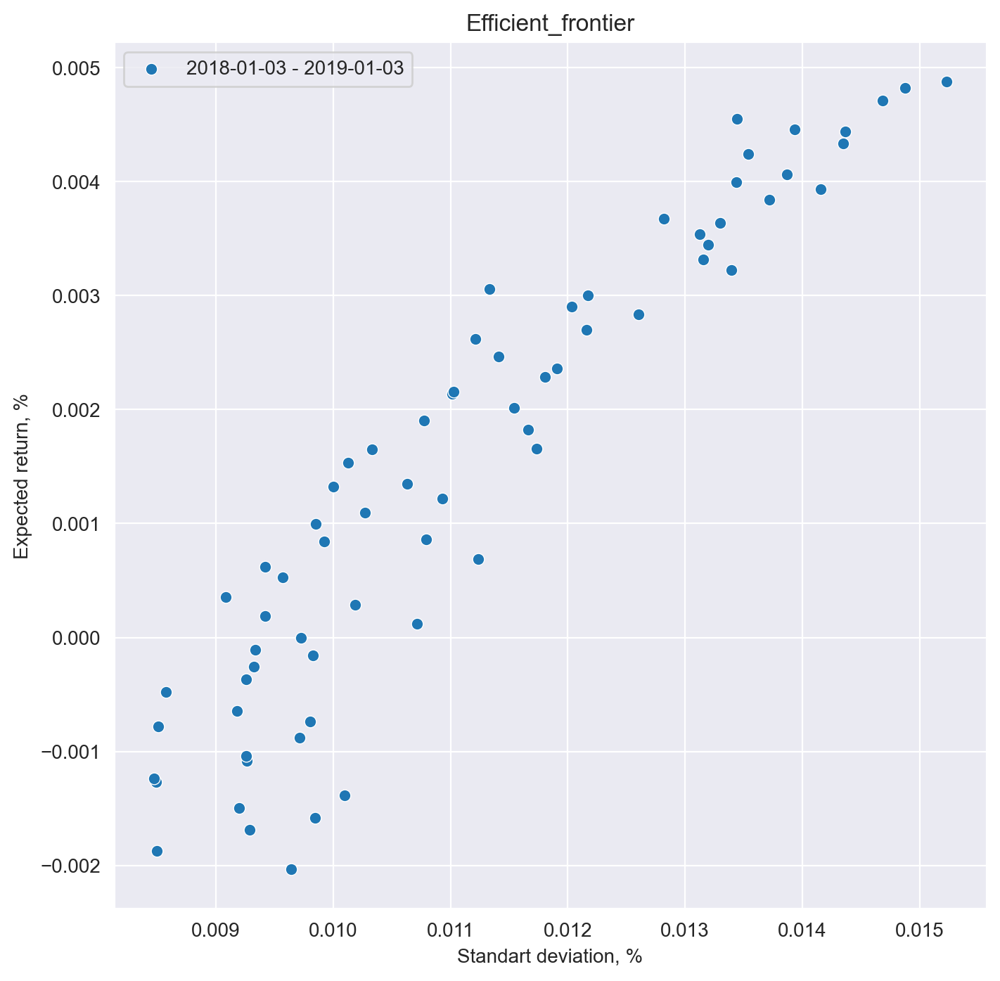

In [41]:
fig, ax = plt.subplots(figsize=(8,8))
for window, cov_matrix in cov_matrices_2018.items():
    steps = list(map(int,window.split('-')))
    start = dates[steps[0]]
    end =  dates[steps[1]] if steps[1] <= len(dates) else dates[len(dates) - 1]

    # Средняя доходность за период (ваш расчет или исторические данные)
    df_current = df_stocks.iloc[steps[0]:steps[1]]
    mean_returns = df_current.mean().values
    
    # Оптимизация
    optim = Optimizer(df_current, mean_return=mean_returns, cov_return=cov_matrix.values)
    res_5 = optim.efficient_frontier_curve(n_point=5000)

    plot_efficient_frontier_curve([x[1] for x in res_5], [x[0] for x in res_5], label=f'{start} - {end}', ax=ax)

  0%|          | 0/500 [00:00<?, ?it/s]

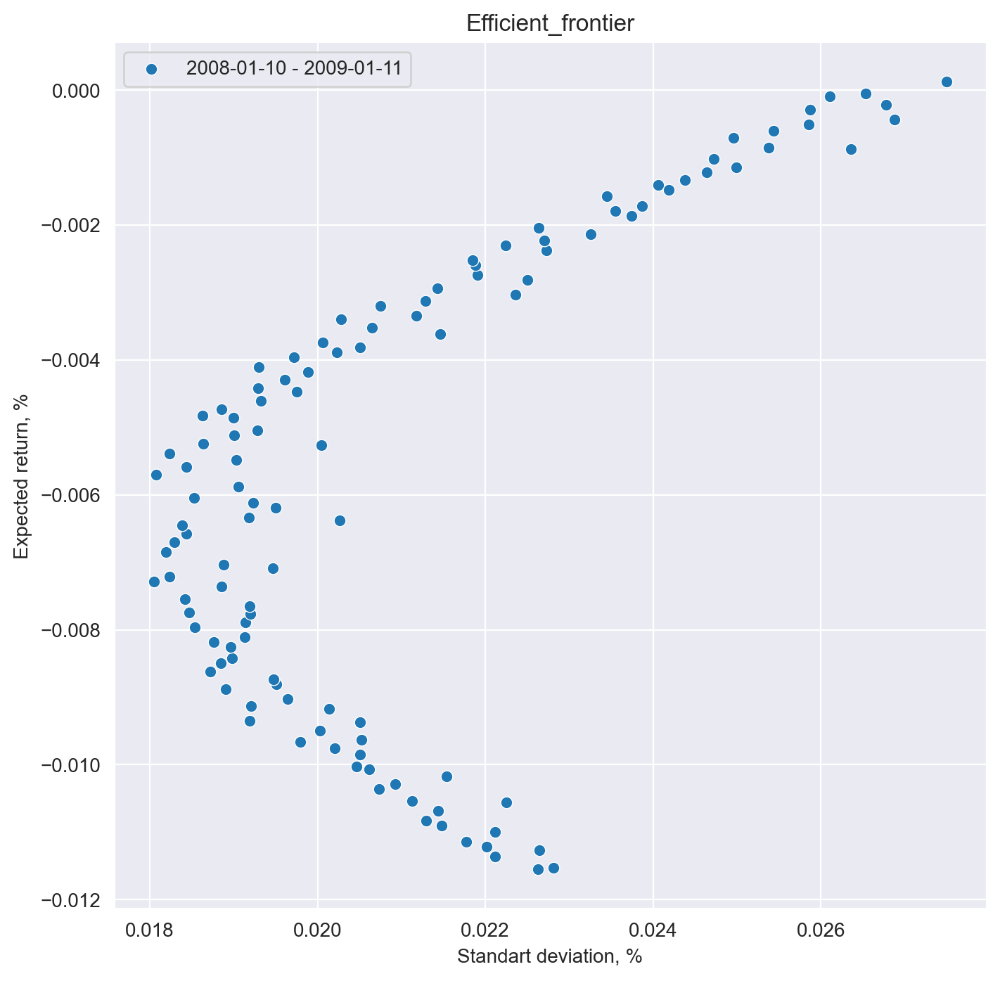

In [ ]:
fig, ax = plt.subplots(figsize=(8,8))
for window, cov_matrix in cov_matrices_2008.items():
    steps = list(map(int,window.split('-')))
    start = dates[steps[0]]
    end =  dates[steps[1]] if steps[1] <= len(dates) else dates[len(dates) - 1]

    # Средняя доходность за период (ваш расчет или исторические данные)
    df_current = df_stocks.iloc[steps[0]:steps[1]]
    mean_returns = df_current.mean().values
    
    # Оптимизация
    optim = Optimizer(df_current, mean_return=mean_returns, cov_return=cov_matrix.values)
    res_5 = optim.efficient_frontier_curve(n_point=1000)

    plot_efficient_frontier_curve([x[1] for x in res_5], [x[0] for x in res_5], label=f'{start} - {end}', ax=ax)

Мы видим, что граница эффективных портфелей за 10 лет значительно изменилась. В 2018 году российские акции начали показывать доходность и их риск снизился.

## Задание 15

Воспользуемся функцией `plot_with_pagination` для отрисовки графиков.

### Скользящее окно

Ширина окна - 1 год, шаг - 1 год

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

C:\Temp\ipykernel_59136\1232068124.py:86: UserWarning: The figure layout has changed to tight
  plt.tight_layout()


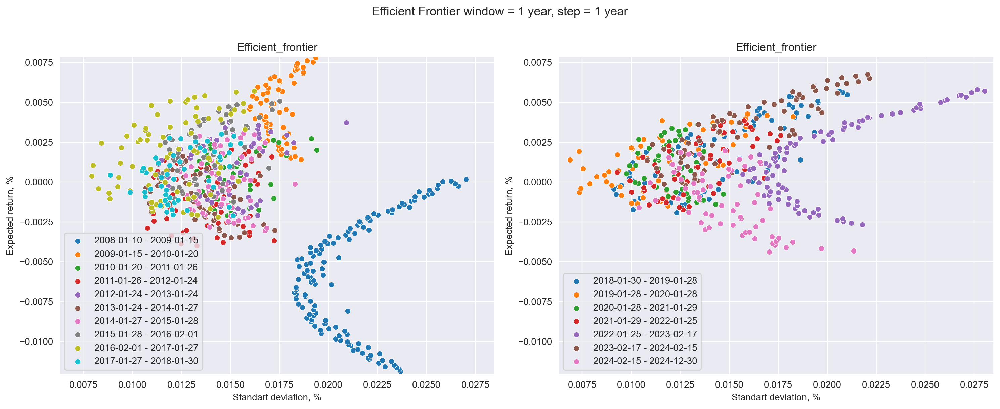

In [ ]:
idx = date_data.index
df_beta, var_r = beta_calculation(df_stocks, idx, df_index)
cov_matrices = cov_with_beta(df_beta, var_r)
plot_with_pagination(cov_matrices, dates, df_stocks, title="Efficient Frontier window = 1 year, step = 1 year")

Ширина окна - 1 год, шаг - 1 квартал

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

c:\Users\Пользователь\Downloads\Risk management\portfolio_analytics\beta.py:188: UserWarning: The figure layout has changed to tight
  plt.tight_layout()


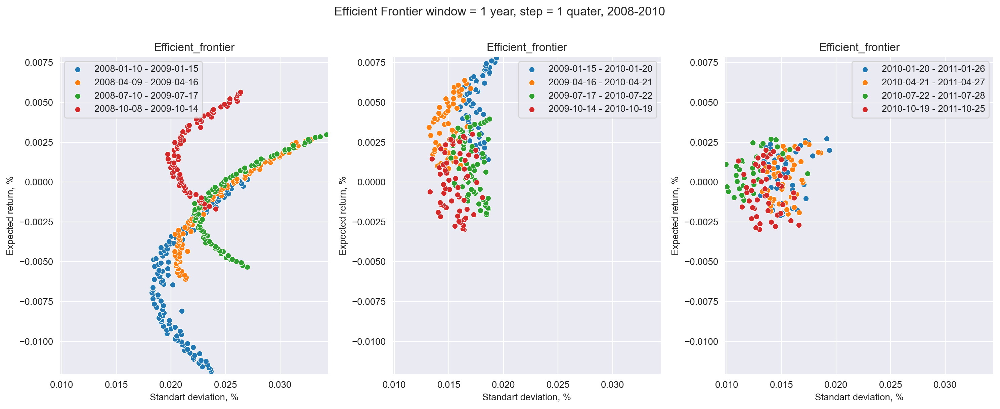

In [ ]:
idx = date_data[(date_data.dt.year >= 2008) & (date_data.dt.year <= 2010)].index
df_beta, var_r = beta_calculation(df_stocks, idx, df_index, window=252, steps=63)
cov_matrices = cov_with_beta(df_beta, var_r)
plot_with_pagination(cov_matrices, dates, df_stocks, n_graph=4, n_cols=3, 
                     title="Efficient Frontier window = 1 year, step = 1 quater, 2008-2010")

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

c:\Users\Пользователь\Downloads\Risk management\portfolio_analytics\beta.py:188: UserWarning: The figure layout has changed to tight
  plt.tight_layout()


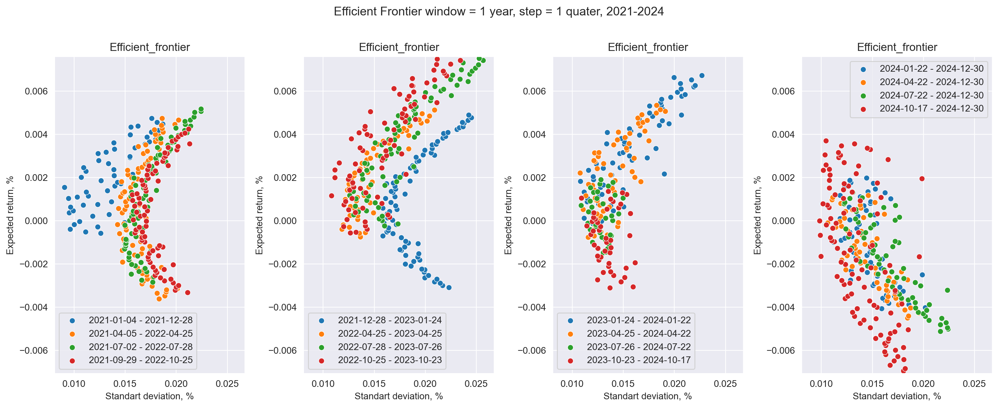

In [ ]:
idx = date_data[(date_data.dt.year >= 2021) & (date_data.dt.year <= 2024)].index
df_beta, var_r = beta_calculation(df_stocks, idx, df_index, window=252, steps=63)
cov_matrices = cov_with_beta(df_beta, var_r)
plot_with_pagination(cov_matrices, dates, df_stocks, n_graph=4, n_cols=4, 
                     title="Efficient Frontier window = 1 year, step = 1 quater, 2021-2024")

Ширина окна - 1 год, шаг - 1 месяц

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

c:\Users\Пользователь\Downloads\Risk management\portfolio_analytics\beta.py:188: UserWarning: The figure layout has changed to tight
  plt.tight_layout()


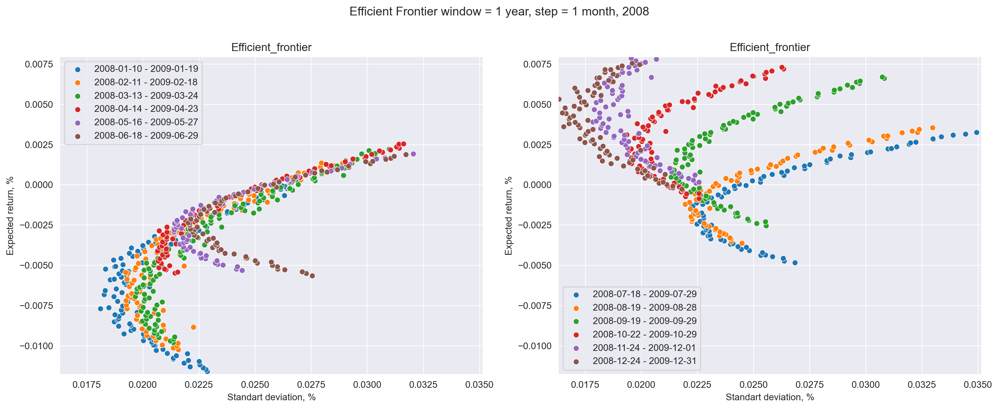

In [ ]:
idx = date_data[date_data.dt.year == 2008].index
df_beta, var_r = beta_calculation(df_stocks, idx, df_index, window=254, steps=22)
cov_matrices = cov_with_beta(df_beta, var_r)
plot_with_pagination(cov_matrices, dates, df_stocks, n_graph=6, n_cols=2,
                      title="Efficient Frontier window = 1 year, step = 1 month, 2008")

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

c:\Users\Пользователь\Downloads\Risk management\portfolio_analytics\beta.py:188: UserWarning: The figure layout has changed to tight
  plt.tight_layout()


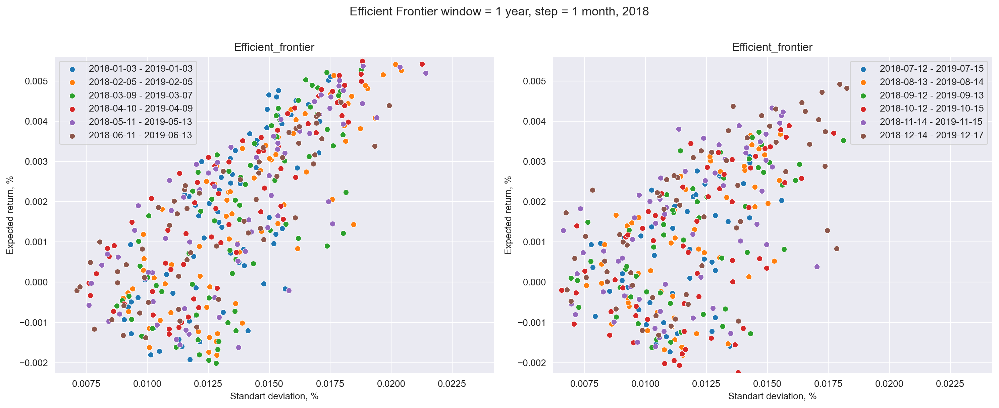

In [ ]:
idx = date_data[date_data.dt.year == 2018].index
df_beta, var_r = beta_calculation(df_stocks, idx, df_index, window=254, steps=22)
cov_matrices = cov_with_beta(df_beta, var_r)
plot_with_pagination(cov_matrices, dates, df_stocks, n_graph=6, n_cols=2,
                      title="Efficient Frontier window = 1 year, step = 1 month, 2018")

Ширина окна - 1 год, шаг - 1 неделя

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

c:\Users\Пользователь\Downloads\Risk management\portfolio_analytics\beta.py:188: UserWarning: The figure layout has changed to tight
  plt.tight_layout()


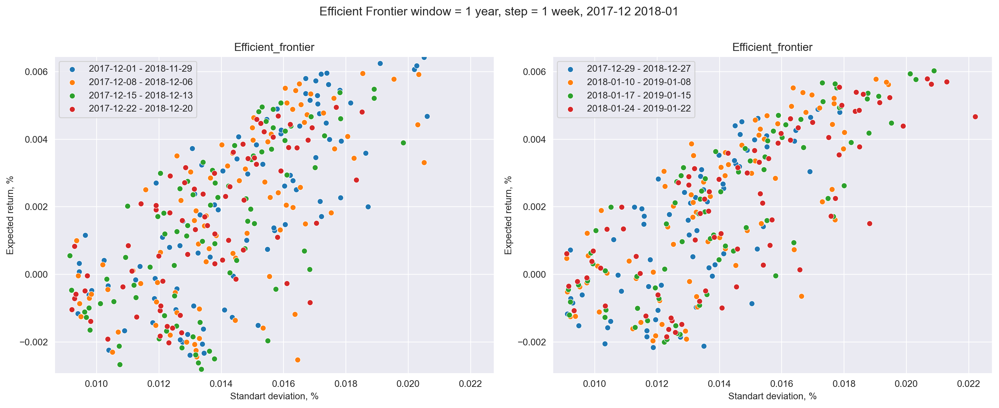

In [ ]:
idx = date_data[((date_data.dt.year == 2017) & (date_data.dt.month == 12)) | ((date_data.dt.year == 2018) & (date_data.dt.month == 1))].index
df_beta, var_r = beta_calculation(df_stocks, idx, df_index, window=252, steps=5)
cov_matrices = cov_with_beta(df_beta, var_r)
plot_with_pagination(cov_matrices, dates, df_stocks, n_graph=4, n_cols=2,
                      title="Efficient Frontier window = 1 year, step = 1 week, 2017-12 2018-01")

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

c:\Users\Пользователь\Downloads\Risk management\portfolio_analytics\beta.py:188: UserWarning: The figure layout has changed to tight
  plt.tight_layout()


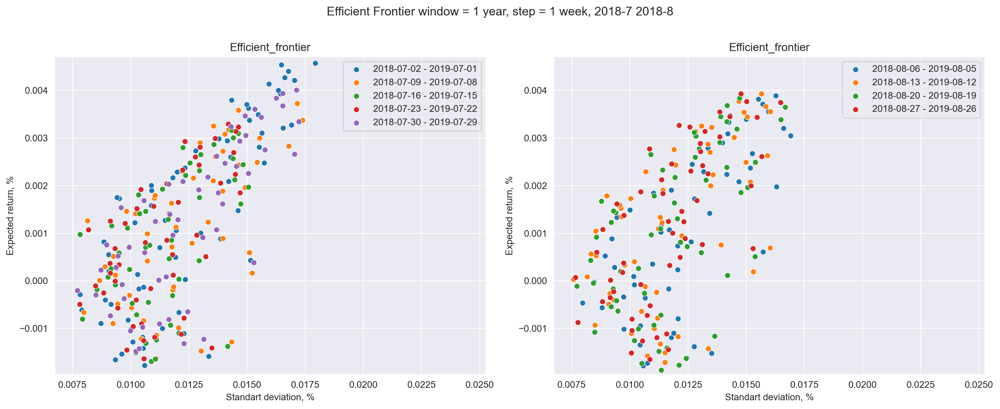

In [ ]:
idx = date_data[((date_data.dt.year == 2018) & (date_data.dt.month == 7)) | ((date_data.dt.year == 2018) & (date_data.dt.month == 8))].index
df_beta, var_r = beta_calculation(df_stocks, idx, df_index, window=252, steps=5)
cov_matrices = cov_with_beta(df_beta, var_r)
plot_with_pagination(cov_matrices, dates, df_stocks, n_graph=5, n_cols=2,
                      title="Efficient Frontier window = 1 year, step = 1 week, 2018-7 2018-8")

Ширина окна 1 год, шаг - 1 день

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

c:\Users\Пользователь\Downloads\Risk management\portfolio_analytics\beta.py:188: UserWarning: The figure layout has changed to tight
  plt.tight_layout()


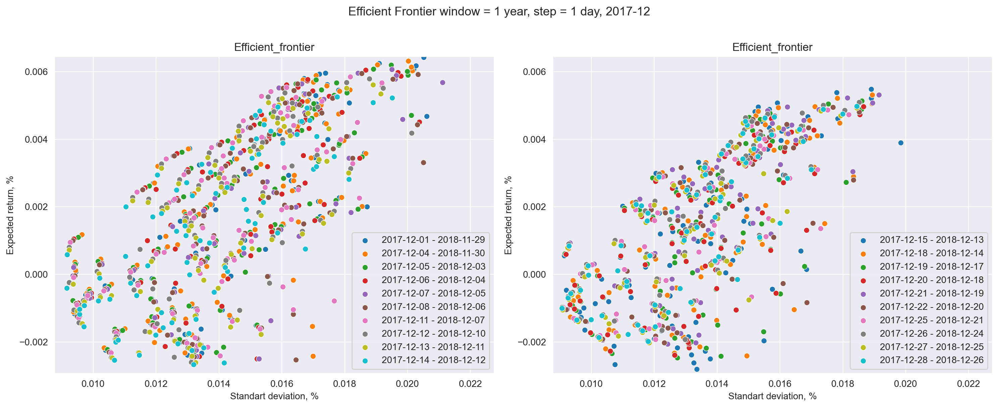

In [ ]:
idx = date_data[(date_data.dt.year == 2017) & (date_data.dt.month == 12) ].index
df_beta, var_r = beta_calculation(df_stocks, idx, df_index, window=252, steps=1)
cov_matrices = cov_with_beta(df_beta, var_r)
plot_with_pagination(cov_matrices, dates, df_stocks, n_graph=10, n_cols=2,
                      title="Efficient Frontier window = 1 year, step = 1 day, 2017-12")

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

c:\Users\Пользователь\Downloads\Risk management\portfolio_analytics\beta.py:188: UserWarning: The figure layout has changed to tight
  plt.tight_layout()


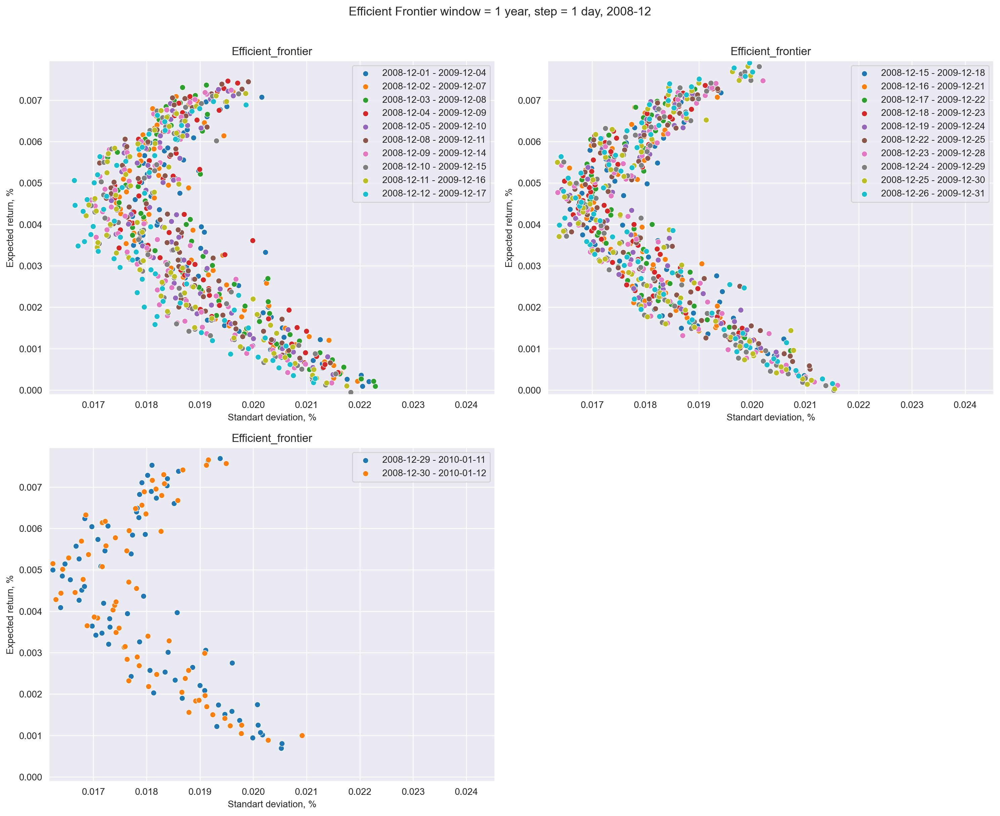

In [ ]:
idx = date_data[(date_data.dt.year == 2008) & (date_data.dt.month == 12) ].index
df_beta, var_r = beta_calculation(df_stocks, idx, df_index, window=252, steps=1)
cov_matrices = cov_with_beta(df_beta, var_r)
plot_with_pagination(cov_matrices, dates, df_stocks, n_graph=10, n_cols=2,
                      title="Efficient Frontier window = 1 year, step = 1 day, 2008-12")

### Расширяющееся окно

Ширина окна 1 год, ширина шага - год

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

c:\Users\Пользователь\Downloads\Risk management\portfolio_analytics\beta.py:188: UserWarning: The figure layout has changed to tight
  plt.tight_layout()


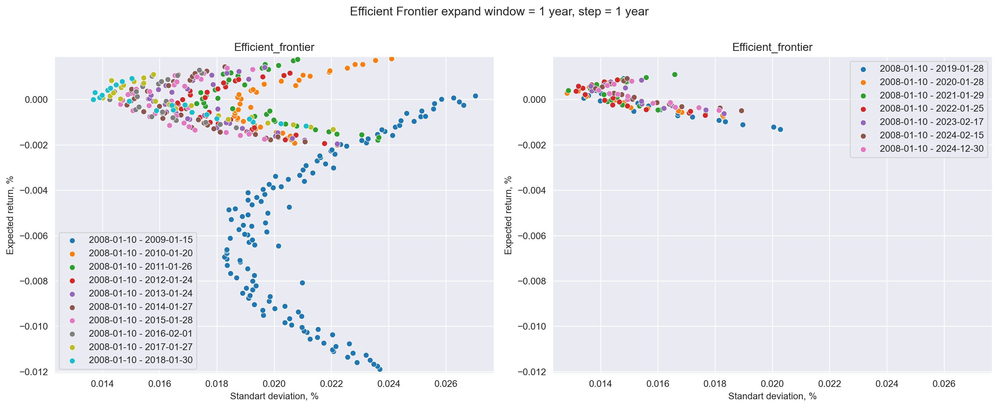

In [ ]:
idx = date_data.index
df_beta, var_r = beta_calculation(df_stocks, idx, df_index, expand=True)
cov_matrices = cov_with_beta(df_beta, var_r)
plot_with_pagination(cov_matrices, dates, df_stocks, title="Efficient Frontier expand window = 1 year, step = 1 year")

Ширина окна 1 год, шаг - 1 квартал

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

c:\Users\Пользователь\Downloads\Risk management\portfolio_analytics\beta.py:188: UserWarning: The figure layout has changed to tight
  plt.tight_layout()


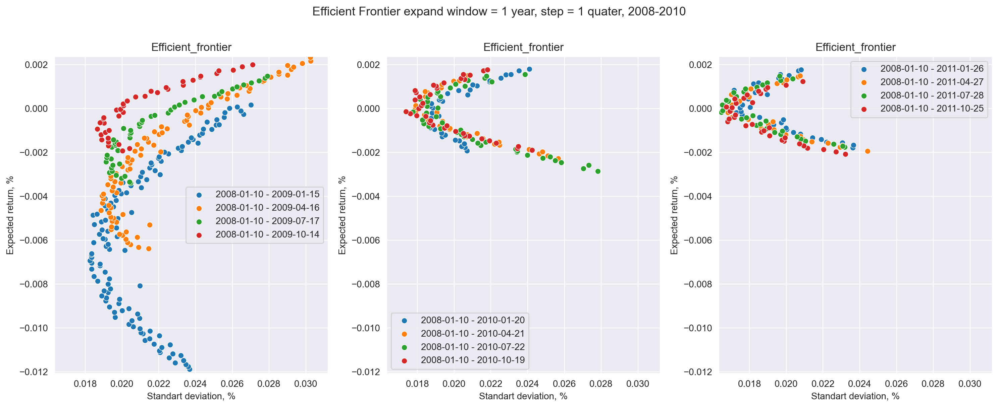

In [ ]:
idx = date_data[(date_data.dt.year >= 2008) & (date_data.dt.year <= 2010)].index
df_beta, var_r = beta_calculation(df_stocks, idx, df_index, window=252, steps=63, expand=True)
cov_matrices = cov_with_beta(df_beta, var_r)
plot_with_pagination(cov_matrices, dates, df_stocks, n_graph=4, n_cols=3, 
                     title="Efficient Frontier expand window = 1 year, step = 1 quater, 2008-2010")

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

c:\Users\Пользователь\Downloads\Risk management\portfolio_analytics\beta.py:188: UserWarning: The figure layout has changed to tight
  plt.tight_layout()


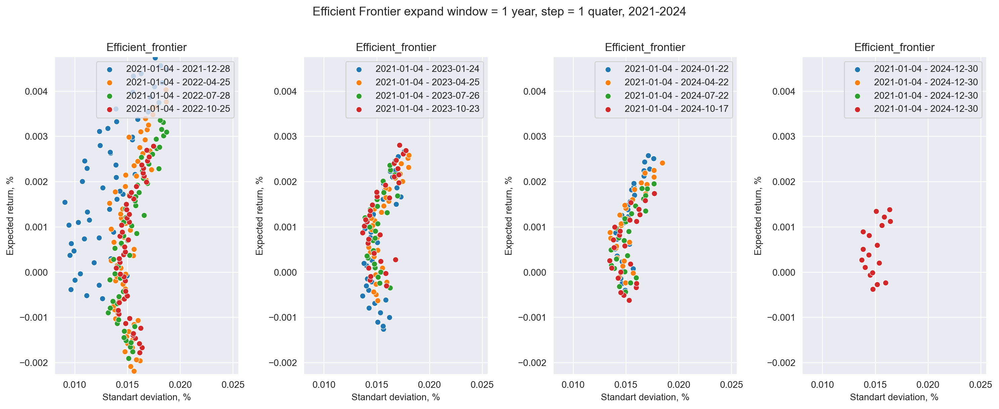

In [ ]:
idx = date_data[(date_data.dt.year >= 2021) & (date_data.dt.year <= 2024)].index
df_beta, var_r = beta_calculation(df_stocks, idx, df_index, window=252, steps=63, expand=True)
cov_matrices = cov_with_beta(df_beta, var_r)
plot_with_pagination(cov_matrices, dates, df_stocks, n_graph=4, n_cols=4, 
                     title="Efficient Frontier expand window = 1 year, step = 1 quater, 2021-2024")

Ширина 1 год, шаг 1 месяц

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

c:\Users\Пользователь\Downloads\Risk management\portfolio_analytics\beta.py:188: UserWarning: The figure layout has changed to tight
  plt.tight_layout()


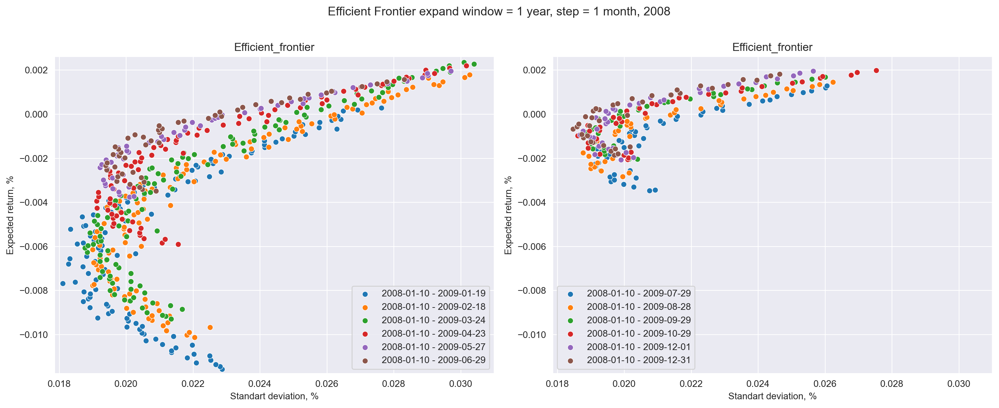

In [ ]:
idx = date_data[date_data.dt.year == 2008].index
df_beta, var_r = beta_calculation(df_stocks, idx, df_index, window=254, steps=22, expand=True)
cov_matrices = cov_with_beta(df_beta, var_r)
plot_with_pagination(cov_matrices, dates, df_stocks, n_graph=6, n_cols=2,
                      title="Efficient Frontier expand window = 1 year, step = 1 month, 2008")

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

c:\Users\Пользователь\Downloads\Risk management\portfolio_analytics\beta.py:188: UserWarning: The figure layout has changed to tight
  plt.tight_layout()


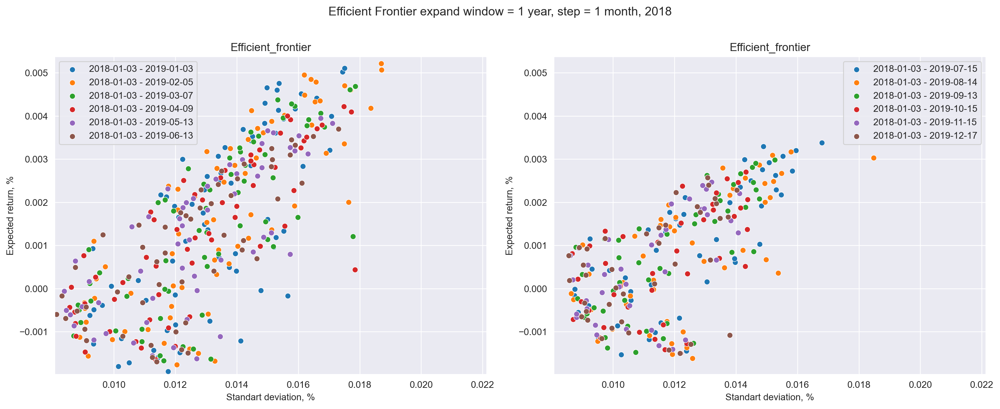

In [ ]:
idx = date_data[date_data.dt.year == 2018].index
df_beta, var_r = beta_calculation(df_stocks, idx, df_index, window=254, steps=22, expand=True)
cov_matrices = cov_with_beta(df_beta, var_r)
plot_with_pagination(cov_matrices, dates, df_stocks, n_graph=6, n_cols=2,
                      title="Efficient Frontier expand window = 1 year, step = 1 month, 2018")

Ширина 1 год, шаг 1 неделя

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

c:\Users\Пользователь\Downloads\Risk management\portfolio_analytics\beta.py:188: UserWarning: The figure layout has changed to tight
  plt.tight_layout()


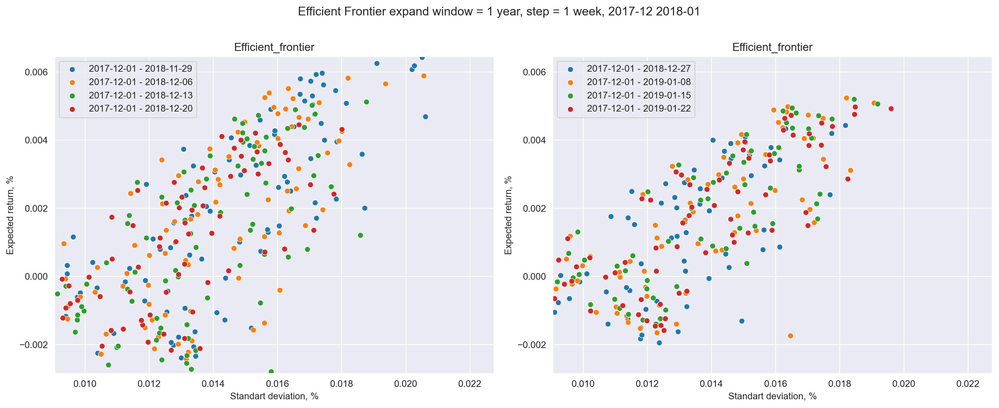

In [ ]:
idx = date_data[((date_data.dt.year == 2017) & (date_data.dt.month == 12)) | ((date_data.dt.year == 2018) & (date_data.dt.month == 1))].index
df_beta, var_r = beta_calculation(df_stocks, idx, df_index, window=252, steps=5, expand=True)
cov_matrices = cov_with_beta(df_beta, var_r)
plot_with_pagination(cov_matrices, dates, df_stocks, n_graph=4, n_cols=2,
                      title="Efficient Frontier expand window = 1 year, step = 1 week, 2017-12 2018-01")

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

c:\Users\Пользователь\Downloads\Risk management\portfolio_analytics\beta.py:188: UserWarning: The figure layout has changed to tight
  plt.tight_layout()


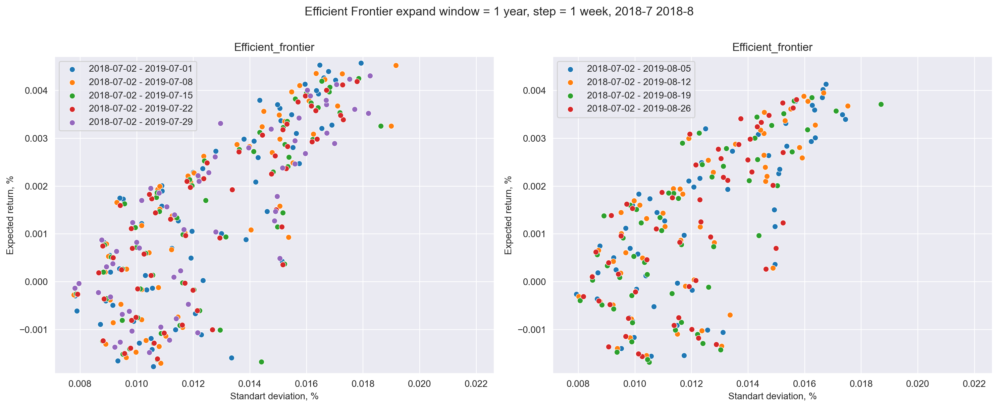

In [ ]:
idx = date_data[((date_data.dt.year == 2018) & (date_data.dt.month == 7)) | ((date_data.dt.year == 2018) & (date_data.dt.month == 8))].index
df_beta, var_r = beta_calculation(df_stocks, idx, df_index, window=252, steps=5, expand=True)
cov_matrices = cov_with_beta(df_beta, var_r)
plot_with_pagination(cov_matrices, dates, df_stocks, n_graph=5, n_cols=2,
                      title="Efficient Frontier expand window = 1 year, step = 1 week, 2018-7 2018-8")

Ширина 1 год, шаг 1 день

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

c:\Users\Пользователь\Downloads\Risk management\portfolio_analytics\beta.py:188: UserWarning: The figure layout has changed to tight
  plt.tight_layout()


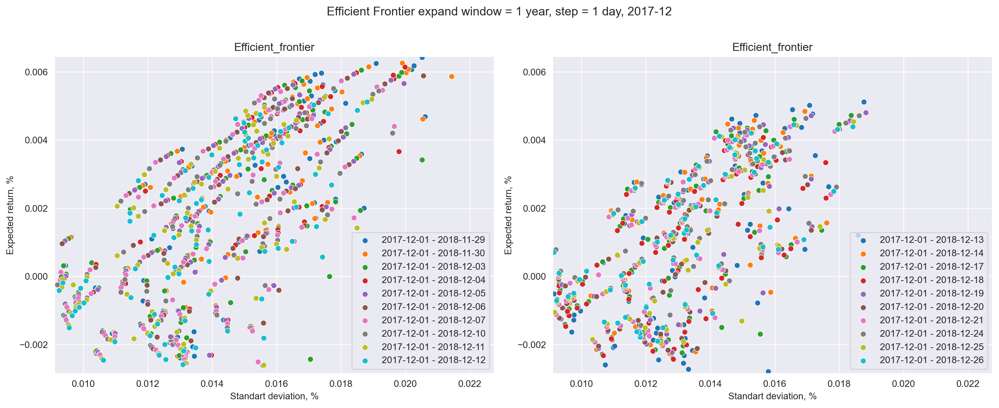

In [ ]:
idx = date_data[(date_data.dt.year == 2017) & (date_data.dt.month == 12) ].index
df_beta, var_r = beta_calculation(df_stocks, idx, df_index, window=252, steps=1, expand=True)
cov_matrices = cov_with_beta(df_beta, var_r)
plot_with_pagination(cov_matrices, dates, df_stocks, n_graph=10, n_cols=2,
                      title="Efficient Frontier expand window = 1 year, step = 1 day, 2017-12")

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

c:\Users\Пользователь\Downloads\Risk management\portfolio_analytics\beta.py:188: UserWarning: The figure layout has changed to tight
  plt.tight_layout()


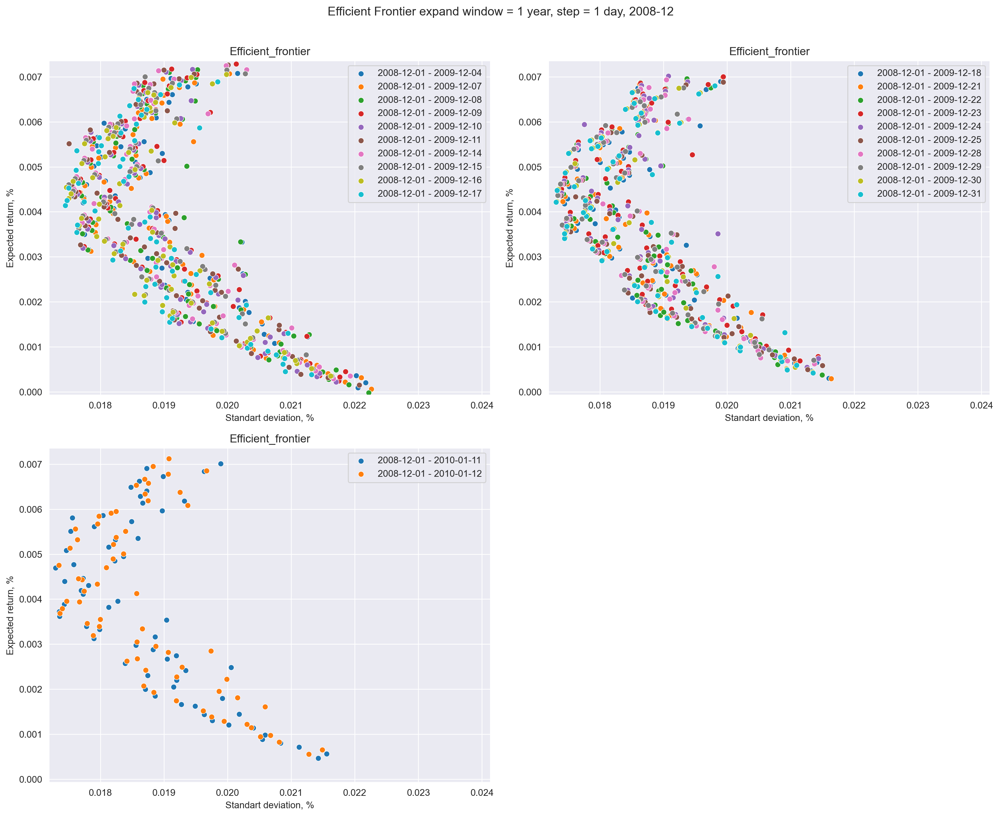

In [ ]:
idx = date_data[(date_data.dt.year == 2008) & (date_data.dt.month == 12) ].index
df_beta, var_r = beta_calculation(df_stocks, idx, df_index, window=252, steps=1, expand=True)
cov_matrices = cov_with_beta(df_beta, var_r)
plot_with_pagination(cov_matrices, dates, df_stocks, n_graph=10, n_cols=2,
                      title="Efficient Frontier expand window = 1 year, step = 1 day, 2008-12")

### Скользящее окно с экспоненциальным забыванием

Ширина окна 1 год, ширина шага - год

In [11]:
alpha = 0.06

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

c:\Users\Пользователь\Downloads\Risk management\portfolio_analytics\beta.py:203: UserWarning: The figure layout has changed to tight
  plt.tight_layout()


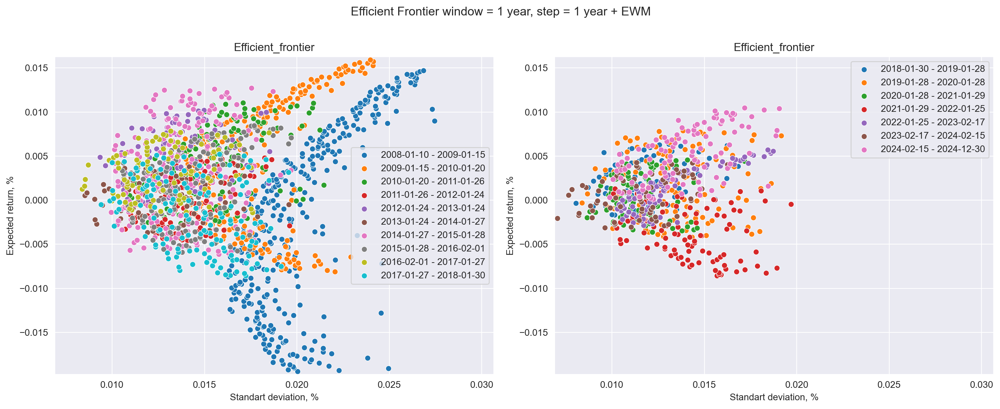

In [12]:
idx = date_data.index
df_beta, var_r = beta_calculation(df_stocks, idx, df_index, alpha = alpha, ewm=True)
cov_matrices = cov_with_beta(df_beta, var_r)
plot_with_pagination(cov_matrices, dates, df_stocks, title="Efficient Frontier window = 1 year, step = 1 year + EWM", alpha=alpha)

Ширина окна 1 год, шаг - 1 квартал

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

c:\Users\Пользователь\Downloads\Risk management\portfolio_analytics\beta.py:203: UserWarning: The figure layout has changed to tight
  plt.tight_layout()


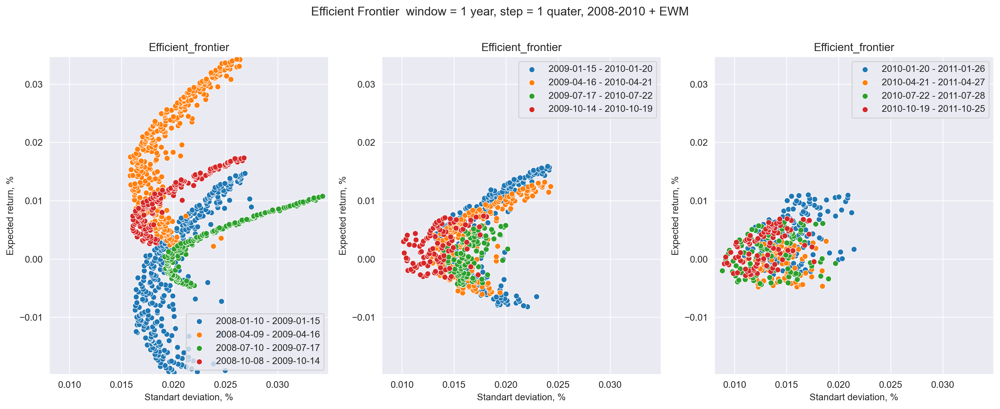

In [13]:
idx = date_data[(date_data.dt.year >= 2008) & (date_data.dt.year <= 2010)].index
df_beta, var_r = beta_calculation(df_stocks, idx, df_index, window=252, steps=63, alpha = alpha, ewm=True)
cov_matrices = cov_with_beta(df_beta, var_r)
plot_with_pagination(cov_matrices, dates, df_stocks, n_graph=4, n_cols=3, 
                     title="Efficient Frontier  window = 1 year, step = 1 quater, 2008-2010 + EWM", alpha = alpha)

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

c:\Users\Пользователь\Downloads\Risk management\portfolio_analytics\beta.py:203: UserWarning: The figure layout has changed to tight
  plt.tight_layout()


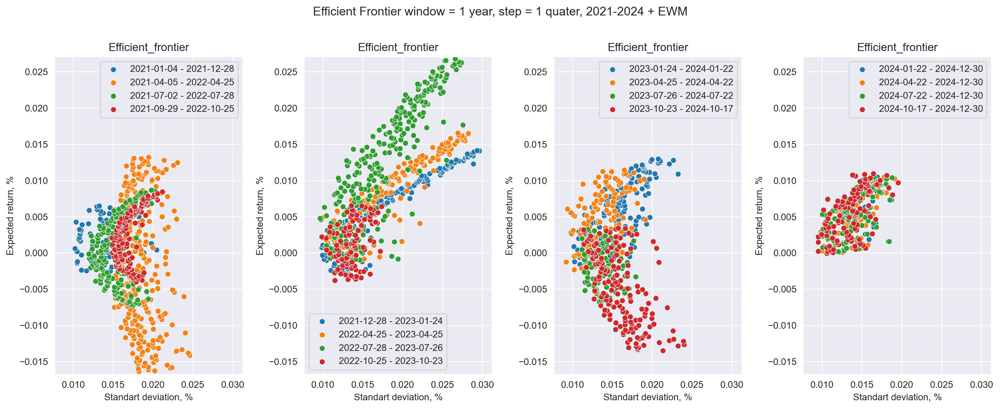

In [14]:
idx = date_data[(date_data.dt.year >= 2021) & (date_data.dt.year <= 2024)].index
df_beta, var_r = beta_calculation(df_stocks, idx, df_index, window=252, steps=63, alpha = alpha, ewm=True)
cov_matrices = cov_with_beta(df_beta, var_r)
plot_with_pagination(cov_matrices, dates, df_stocks, n_graph=4, n_cols=4, 
                     title="Efficient Frontier window = 1 year, step = 1 quater, 2021-2024 + EWM", alpha = alpha)

Ширина 1 год, шаг 1 месяц

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

c:\Users\Пользователь\Downloads\Risk management\portfolio_analytics\beta.py:203: UserWarning: The figure layout has changed to tight
  plt.tight_layout()


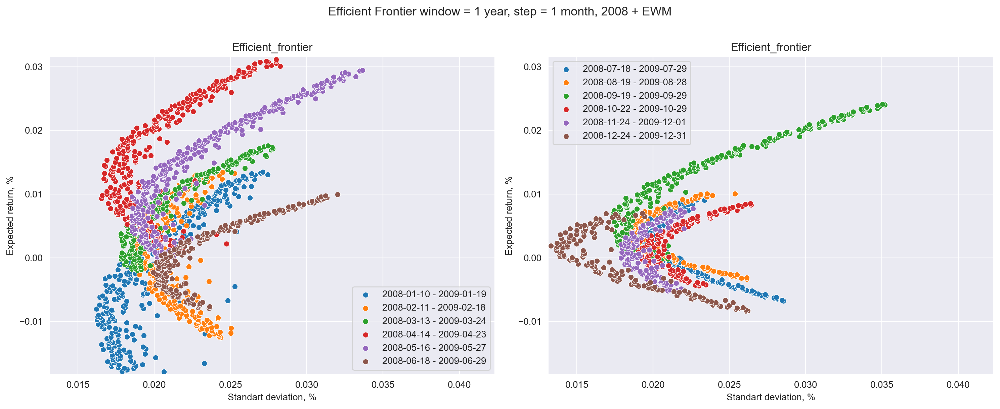

In [15]:
idx = date_data[date_data.dt.year == 2008].index
df_beta, var_r = beta_calculation(df_stocks, idx, df_index, window=254, steps=22, alpha = alpha, ewm=True)
cov_matrices = cov_with_beta(df_beta, var_r)
plot_with_pagination(cov_matrices, dates, df_stocks, n_graph=6, n_cols=2,
                      title="Efficient Frontier window = 1 year, step = 1 month, 2008 + EWM", alpha = alpha)

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

c:\Users\Пользователь\Downloads\Risk management\portfolio_analytics\beta.py:203: UserWarning: The figure layout has changed to tight
  plt.tight_layout()


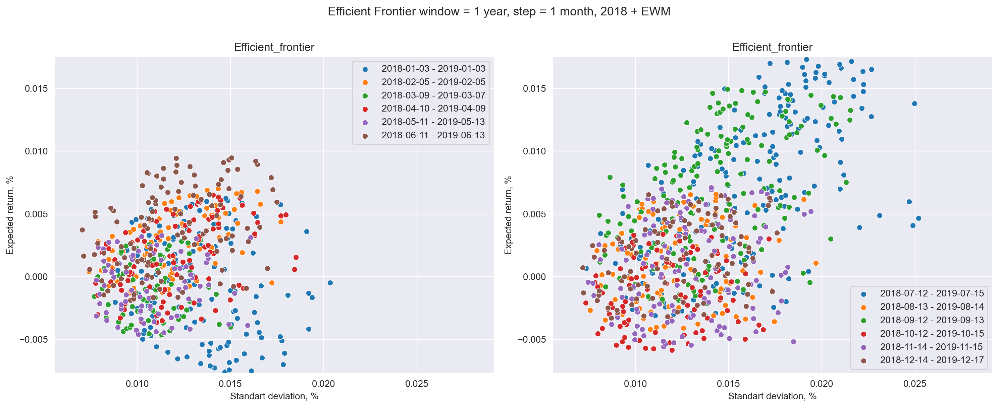

In [16]:
idx = date_data[date_data.dt.year == 2018].index
df_beta, var_r = beta_calculation(df_stocks, idx, df_index, window=254, steps=22, alpha = alpha, ewm=True)
cov_matrices = cov_with_beta(df_beta, var_r)
plot_with_pagination(cov_matrices, dates, df_stocks, n_graph=6, n_cols=2,
                      title="Efficient Frontier window = 1 year, step = 1 month, 2018 + EWM", alpha = alpha)

Ширина 1 год, шаг 1 неделя

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

c:\Users\Пользователь\Downloads\Risk management\portfolio_analytics\beta.py:203: UserWarning: The figure layout has changed to tight
  plt.tight_layout()


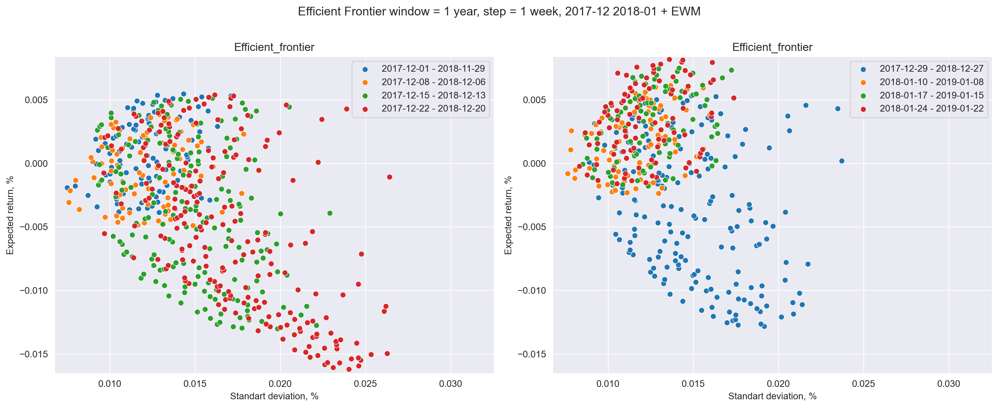

In [17]:
idx = date_data[((date_data.dt.year == 2017) & (date_data.dt.month == 12)) | ((date_data.dt.year == 2018) & (date_data.dt.month == 1))].index
df_beta, var_r = beta_calculation(df_stocks, idx, df_index, window=252, steps=5, alpha = alpha, ewm=True)
cov_matrices = cov_with_beta(df_beta, var_r)
plot_with_pagination(cov_matrices, dates, df_stocks, n_graph=4, n_cols=2,
                      title="Efficient Frontier window = 1 year, step = 1 week, 2017-12 2018-01 + EWM", alpha = alpha)

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

c:\Users\Пользователь\Downloads\Risk management\portfolio_analytics\beta.py:203: UserWarning: The figure layout has changed to tight
  plt.tight_layout()


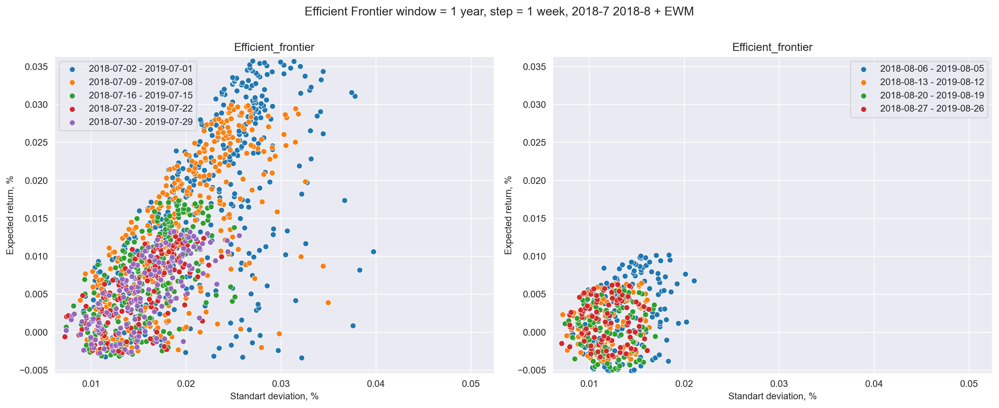

In [18]:
idx = date_data[((date_data.dt.year == 2018) & (date_data.dt.month == 7)) | ((date_data.dt.year == 2018) & (date_data.dt.month == 8))].index
df_beta, var_r = beta_calculation(df_stocks, idx, df_index, window=252, steps=5, alpha = alpha, ewm=True)
cov_matrices = cov_with_beta(df_beta, var_r)
plot_with_pagination(cov_matrices, dates, df_stocks, n_graph=5, n_cols=2,
                      title="Efficient Frontier window = 1 year, step = 1 week, 2018-7 2018-8 + EWM", alpha = alpha)

Ширина 1 год, шаг 1 день

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

c:\Users\Пользователь\Downloads\Risk management\portfolio_analytics\beta.py:203: UserWarning: The figure layout has changed to tight
  plt.tight_layout()


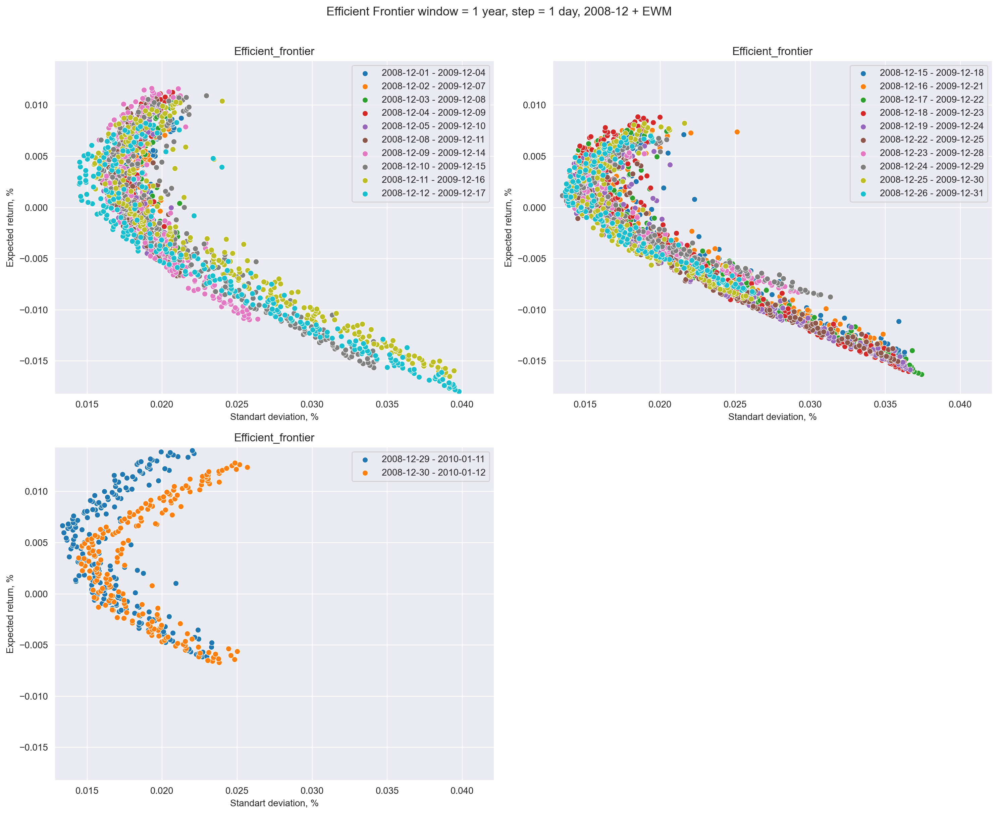

In [19]:
idx = date_data[(date_data.dt.year == 2008) & (date_data.dt.month == 12) ].index
df_beta, var_r = beta_calculation(df_stocks, idx, df_index, window=252, steps=1, ewm=True, alpha=alpha)
cov_matrices = cov_with_beta(df_beta, var_r)
plot_with_pagination(cov_matrices, dates, df_stocks, n_graph=10, n_cols=2,
                      title="Efficient Frontier window = 1 year, step = 1 day, 2008-12 + EWM", alpha = alpha)

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

c:\Users\Пользователь\Downloads\Risk management\portfolio_analytics\beta.py:203: UserWarning: The figure layout has changed to tight
  plt.tight_layout()


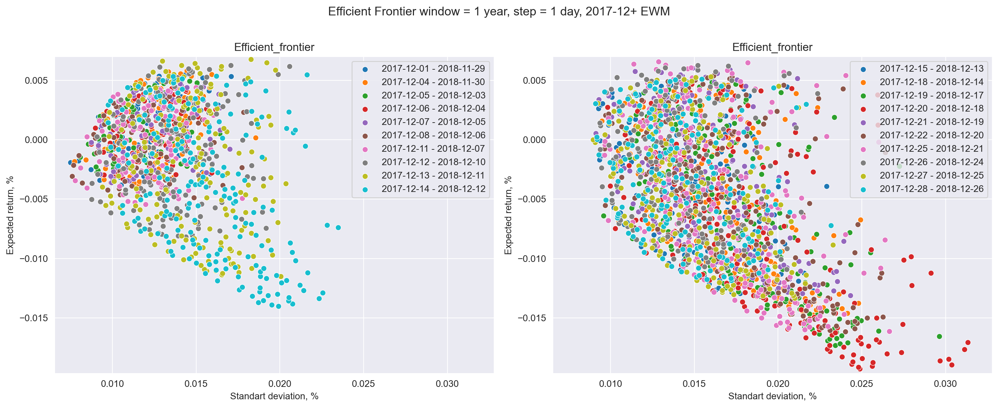

In [20]:
idx = date_data[(date_data.dt.year == 2017) & (date_data.dt.month == 12) ].index
df_beta, var_r = beta_calculation(df_stocks, idx, df_index, window=252, steps=1, ewm=True, alpha=alpha)
cov_matrices = cov_with_beta(df_beta, var_r)
plot_with_pagination(cov_matrices, dates, df_stocks, n_graph=10, n_cols=2,
                      title="Efficient Frontier window = 1 year, step = 1 day, 2017-12+ EWM", alpha = alpha)

### Расширяющееся окно с экспоненциальным забыванием

Ширина окна 1 год, ширина шага - год

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

c:\Users\Пользователь\Downloads\Risk management\portfolio_analytics\beta.py:203: UserWarning: The figure layout has changed to tight
  plt.tight_layout()


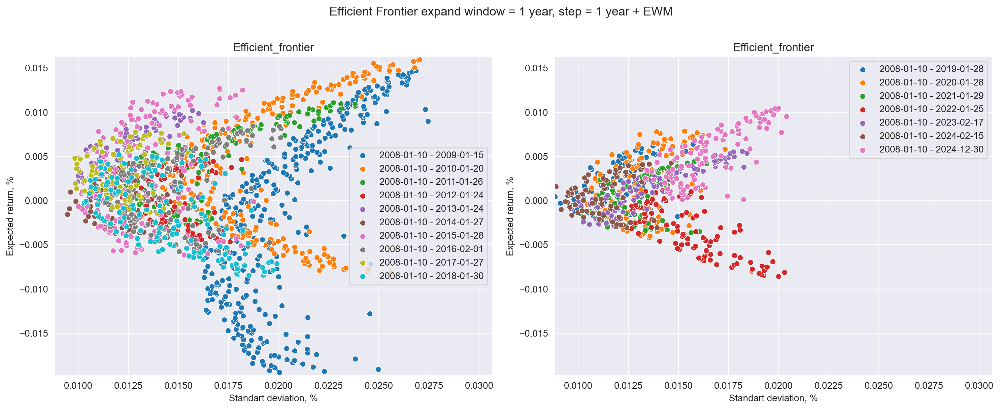

In [21]:
idx = date_data.index
df_beta, var_r = beta_calculation(df_stocks, idx, df_index, expand=True, alpha = alpha, ewm=True)
cov_matrices = cov_with_beta(df_beta, var_r)
plot_with_pagination(cov_matrices, dates, df_stocks, title="Efficient Frontier expand window = 1 year, step = 1 year + EWM", alpha = alpha)

Ширина окна 1 год, шаг - 1 квартал

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

c:\Users\Пользователь\Downloads\Risk management\portfolio_analytics\beta.py:203: UserWarning: The figure layout has changed to tight
  plt.tight_layout()


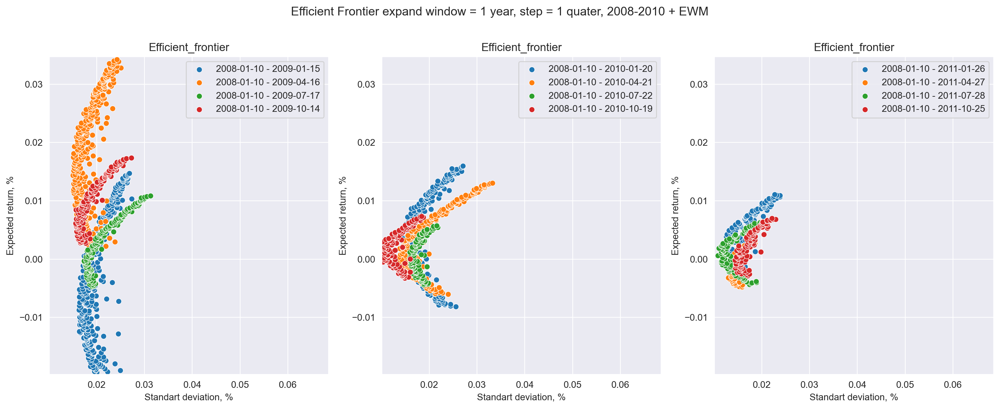

In [22]:
idx = date_data[(date_data.dt.year >= 2008) & (date_data.dt.year <= 2010)].index
df_beta, var_r = beta_calculation(df_stocks, idx, df_index, window=252, steps=63, expand=True, alpha = alpha, ewm=True)
cov_matrices = cov_with_beta(df_beta, var_r)
plot_with_pagination(cov_matrices, dates, df_stocks, n_graph=4, n_cols=3, 
                     title="Efficient Frontier expand window = 1 year, step = 1 quater, 2008-2010 + EWM", alpha = alpha)

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

c:\Users\Пользователь\Downloads\Risk management\portfolio_analytics\beta.py:203: UserWarning: The figure layout has changed to tight
  plt.tight_layout()


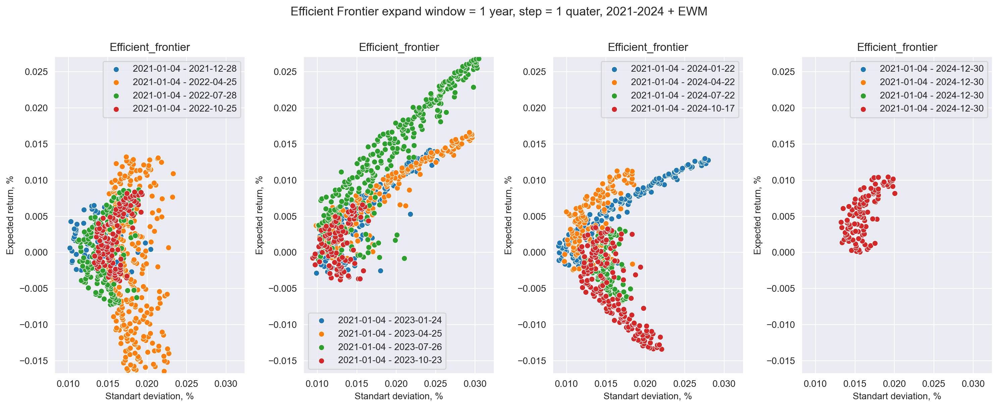

In [23]:
idx = date_data[(date_data.dt.year >= 2021) & (date_data.dt.year <= 2024)].index
df_beta, var_r = beta_calculation(df_stocks, idx, df_index, window=252, steps=63, expand=True, alpha = alpha, ewm=True)
cov_matrices = cov_with_beta(df_beta, var_r)
plot_with_pagination(cov_matrices, dates, df_stocks, n_graph=4, n_cols=4, 
                     title="Efficient Frontier expand window = 1 year, step = 1 quater, 2021-2024 + EWM", alpha = alpha)

Ширина 1 год, шаг 1 месяц

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

c:\Users\Пользователь\Downloads\Risk management\portfolio_analytics\beta.py:203: UserWarning: The figure layout has changed to tight
  plt.tight_layout()


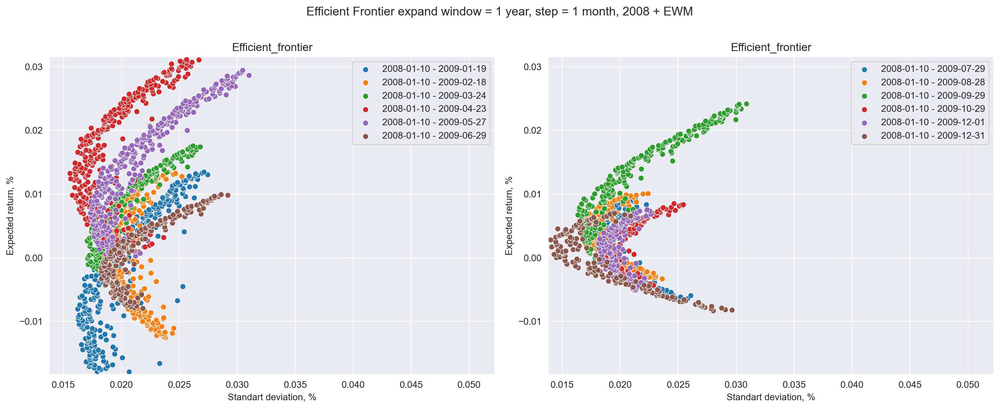

In [24]:
idx = date_data[date_data.dt.year == 2008].index
df_beta, var_r = beta_calculation(df_stocks, idx, df_index, window=254, steps=22, expand=True, alpha = alpha, ewm=True)
cov_matrices = cov_with_beta(df_beta, var_r)
plot_with_pagination(cov_matrices, dates, df_stocks, n_graph=6, n_cols=2,
                      title="Efficient Frontier expand window = 1 year, step = 1 month, 2008 + EWM", alpha = alpha)

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

c:\Users\Пользователь\Downloads\Risk management\portfolio_analytics\beta.py:203: UserWarning: The figure layout has changed to tight
  plt.tight_layout()


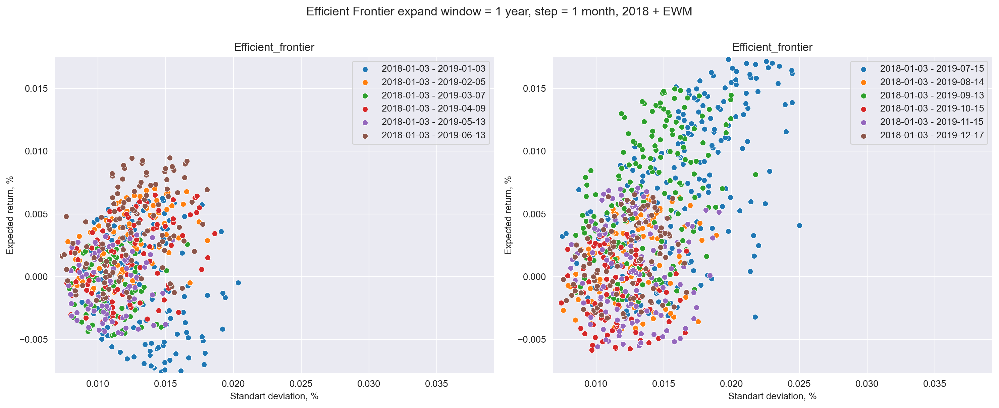

In [25]:
idx = date_data[date_data.dt.year == 2018].index
df_beta, var_r = beta_calculation(df_stocks, idx, df_index, window=254, steps=22, expand=True, alpha = alpha, ewm=True)
cov_matrices = cov_with_beta(df_beta, var_r)
plot_with_pagination(cov_matrices, dates, df_stocks, n_graph=6, n_cols=2,
                      title="Efficient Frontier expand window = 1 year, step = 1 month, 2018 + EWM", alpha = alpha)

Ширина 1 год, шаг 1 неделя

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

c:\Users\Пользователь\Downloads\Risk management\portfolio_analytics\beta.py:203: UserWarning: The figure layout has changed to tight
  plt.tight_layout()


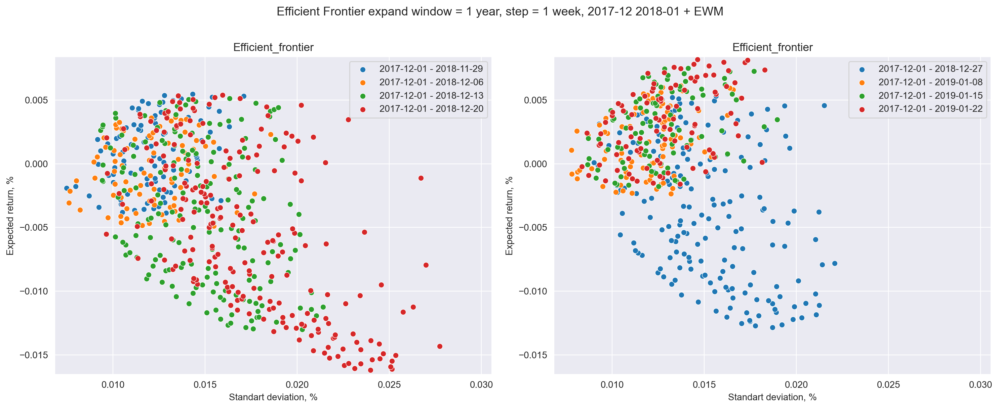

In [26]:
idx = date_data[((date_data.dt.year == 2017) & (date_data.dt.month == 12)) | ((date_data.dt.year == 2018) & (date_data.dt.month == 1))].index
df_beta, var_r = beta_calculation(df_stocks, idx, df_index, window=252, steps=5, expand=True, alpha = alpha, ewm=True)
cov_matrices = cov_with_beta(df_beta, var_r)
plot_with_pagination(cov_matrices, dates, df_stocks, n_graph=4, n_cols=2,
                      title="Efficient Frontier expand window = 1 year, step = 1 week, 2017-12 2018-01 + EWM", alpha = alpha)

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

c:\Users\Пользователь\Downloads\Risk management\portfolio_analytics\beta.py:203: UserWarning: The figure layout has changed to tight
  plt.tight_layout()


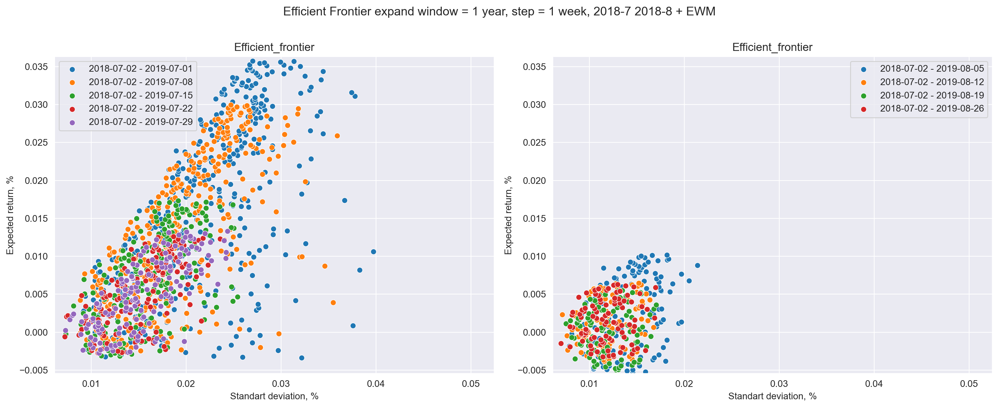

In [27]:
idx = date_data[((date_data.dt.year == 2018) & (date_data.dt.month == 7)) | ((date_data.dt.year == 2018) & (date_data.dt.month == 8))].index
df_beta, var_r = beta_calculation(df_stocks, idx, df_index, window=252, steps=5, expand=True, alpha = alpha, ewm=True)
cov_matrices = cov_with_beta(df_beta, var_r)
plot_with_pagination(cov_matrices, dates, df_stocks, n_graph=5, n_cols=2,
                      title="Efficient Frontier expand window = 1 year, step = 1 week, 2018-7 2018-8 + EWM", alpha = alpha)

Ширина 1 год, шаг 1 день

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

c:\Users\Пользователь\Downloads\Risk management\portfolio_analytics\beta.py:203: UserWarning: The figure layout has changed to tight
  plt.tight_layout()


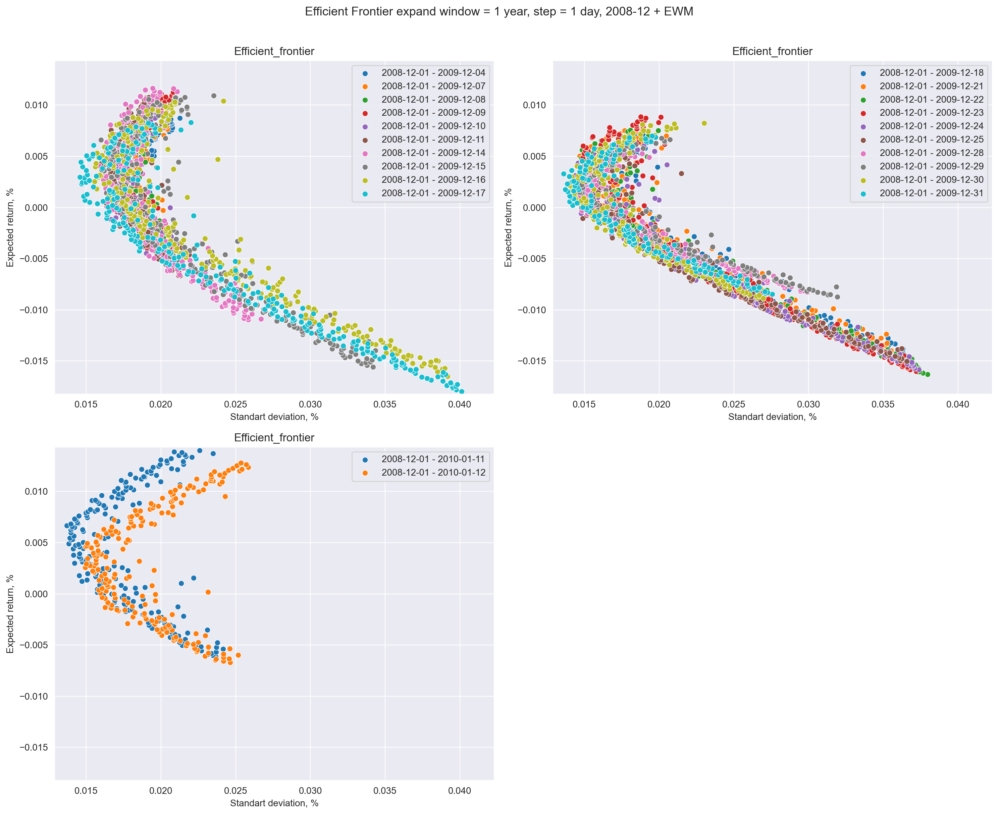

In [28]:
idx = date_data[(date_data.dt.year == 2008) & (date_data.dt.month == 12) ].index
df_beta, var_r = beta_calculation(df_stocks, idx, df_index, window=252, steps=1, expand = True, ewm=True, alpha=alpha)
cov_matrices = cov_with_beta(df_beta, var_r)
plot_with_pagination(cov_matrices, dates, df_stocks, n_graph=10, n_cols=2,
                      title="Efficient Frontier expand window = 1 year, step = 1 day, 2008-12 + EWM", alpha = alpha)

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

c:\Users\Пользователь\Downloads\Risk management\portfolio_analytics\beta.py:203: UserWarning: The figure layout has changed to tight
  plt.tight_layout()


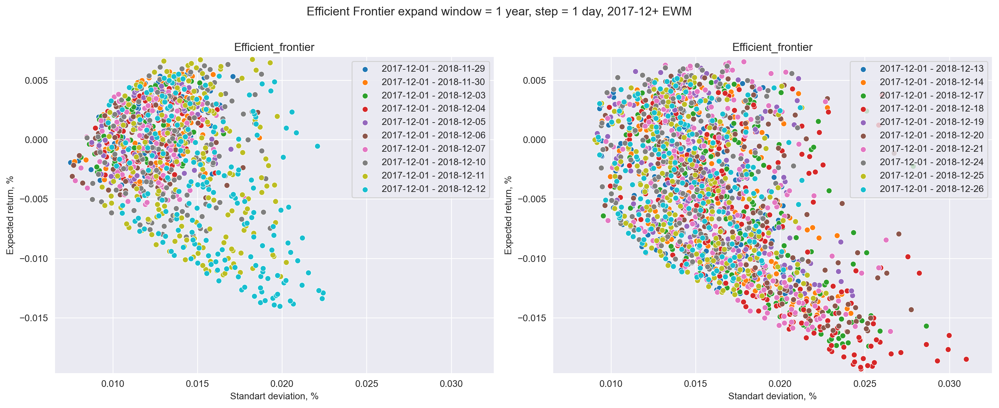

In [29]:
idx = date_data[(date_data.dt.year == 2017) & (date_data.dt.month == 12) ].index
df_beta, var_r = beta_calculation(df_stocks, idx, df_index, window=252, steps=1, expand=True, ewm=True, alpha=alpha)
cov_matrices = cov_with_beta(df_beta, var_r)
plot_with_pagination(cov_matrices, dates, df_stocks, n_graph=10, n_cols=2,
                      title="Efficient Frontier expand window = 1 year, step = 1 day, 2017-12+ EWM", alpha = alpha)